# imports and settings

In [1]:
from SEAM.utils import *
import SEAM
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
import anndata as ad
import faiss
import sys
import heapq
from math import sqrt

/home/yzy/anaconda3/envs/scaden/lib/python3.7/site-packages/anndata/_core/anndata.py:21: FutureWarning: pandas.core.index is deprecated and will be removed in a future version.  The public classes are available in the top-level namespace.
  from pandas.core.index import RangeIndex
Using TensorFlow backend.


In [2]:
sns.set_style('white')
# font = {'family' : 'normal',
#         'weight' : 'bold',
#         'size'   : 2}

# matplotlib.rc('font', **font)
# matplotlib.rcParams.update({'font.size': 2})

import matplotlib.pyplot as plt

SMALL_SIZE = 8
MEDIUM_SIZE = 10
BIGGER_SIZE = 12

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title

# functions

In [3]:
def ij2ind(i,j,rows=256):
    return i+j*rows

In [4]:
def get_adata_pixel(a):
    in_X = a.uns['IMS']
    matters_list = np.array(a.var_names)
    # obs_name = cell_list
    obs_name = map(str,range(in_X.shape[0]))
    g = map(str,matters_list)
    # g = matters_list

    obs = pd.DataFrame(index=obs_name)

    # var_name must be str
    var = pd.DataFrame(index=g)

    adata = ad.AnnData(in_X,  obs=obs,var=var, dtype='float32')
    a_tmp = np.arange(65536)
    a_tmp_sq = a_tmp.reshape(256,256)
    x_list = [np.where(a_tmp_sq==i)[0][0] for i in a_tmp]
    y_list = [np.where(a_tmp_sq==i)[1][0] for i in a_tmp]
    x_list = np.array(x_list)
    y_list = np.array(y_list)
    
    adata.obsm['spatial'] = np.concatenate((x_list.reshape(-1,1),y_list.reshape(-1,1)),axis=1)
#     adata.obs['spatial_x'] = y_list
#     adata.obs['spatial_y'] = x_list
    return adata

In [5]:
# partition IMS as grid
def get_grid_label(grid_sz):
    pixel_label_mat = np.zeros(shape=(256,256))

    # cell_pos and cell_idx both starts with 1

    # grid_sz = 8
    n_grid_per_row = 256/grid_sz
    k=0
    for i in range(256):
        for j in range(256):
            grid_idx_i = np.floor(i/grid_sz)
            grid_idx_j = np.floor(j/grid_sz)
            grid_idx = grid_idx_i+grid_idx_j*n_grid_per_row+1

            pixel_label_mat[i,j] = grid_idx
            k+=1
    return pixel_label_mat


def make_adata_by_pixellabel(a,pixel_label_mat):
    # 已知pixel_label_mat，重构出一个a。这样方便之后的super pixel。要求：从1开始。没mask到的背景为0
    # 先把pixel_label_mat处理成从1开始的连续
    IMS = a.uns['IMS'].copy()
    num_cells = int(pixel_label_mat.max())
    train_x = []
    cell_idx = []
    cell_pos = []
    for i in range(num_cells):
        cur_idx = i+1

        cur_pixels_i,cur_pixels_j = np.where(pixel_label_mat==cur_idx)
        cur_pixels_idx = [ij2ind(cur_pixels_i[k],cur_pixels_j[k]) for k in range(len(cur_pixels_i))]
        cur_train_x = IMS[cur_pixels_idx,:]
        cur_cell_idx = np.array([cur_idx]*len(cur_pixels_i))
        cur_cell_pos = np.array(cur_pixels_idx)+1
        train_x.append(cur_train_x)
        cell_idx.append(cur_cell_idx)
        cell_pos.append(cur_cell_pos)
    train_x = np.concatenate(train_x)
    cell_idx = np.concatenate(cell_idx)
    cell_pos = np.concatenate(cell_pos)

    mean_rep = SEAM.datasets.get_mean_representation(train_x,cell_idx,num_cells)

    obs = np.arange(num_cells).astype('str')
    var = a.var_names
    obs = pd.DataFrame(index=obs)
    var = pd.DataFrame(index=var)
    a_grid = ad.AnnData(mean_rep,obs=obs,var=var)
    a_grid.uns['IMS'] = IMS
    a_grid.uns['cell_idx'] = cell_idx
    a_grid.uns['cell_pos'] = cell_pos
    a_grid.uns['train_x'] = train_x

    return a_grid

In [7]:
1+1

2

# data loading

In [8]:
a = sc.read_h5ad('/home/yzy/projects/SEAM/SEAM/data/raw/mouse_liver_raw.h5ad')

In [13]:
pixel_label_mat_8 = get_grid_label(8)
a_grid = make_adata_by_pixellabel(a,pixel_label_mat_8)

# Cut

### get segmented mask and cell position, and write into anndata

In [15]:
a_grid=SEAM.tl.Cut(a_grid)

setting obsm: spatial


## each cell represented as a dot

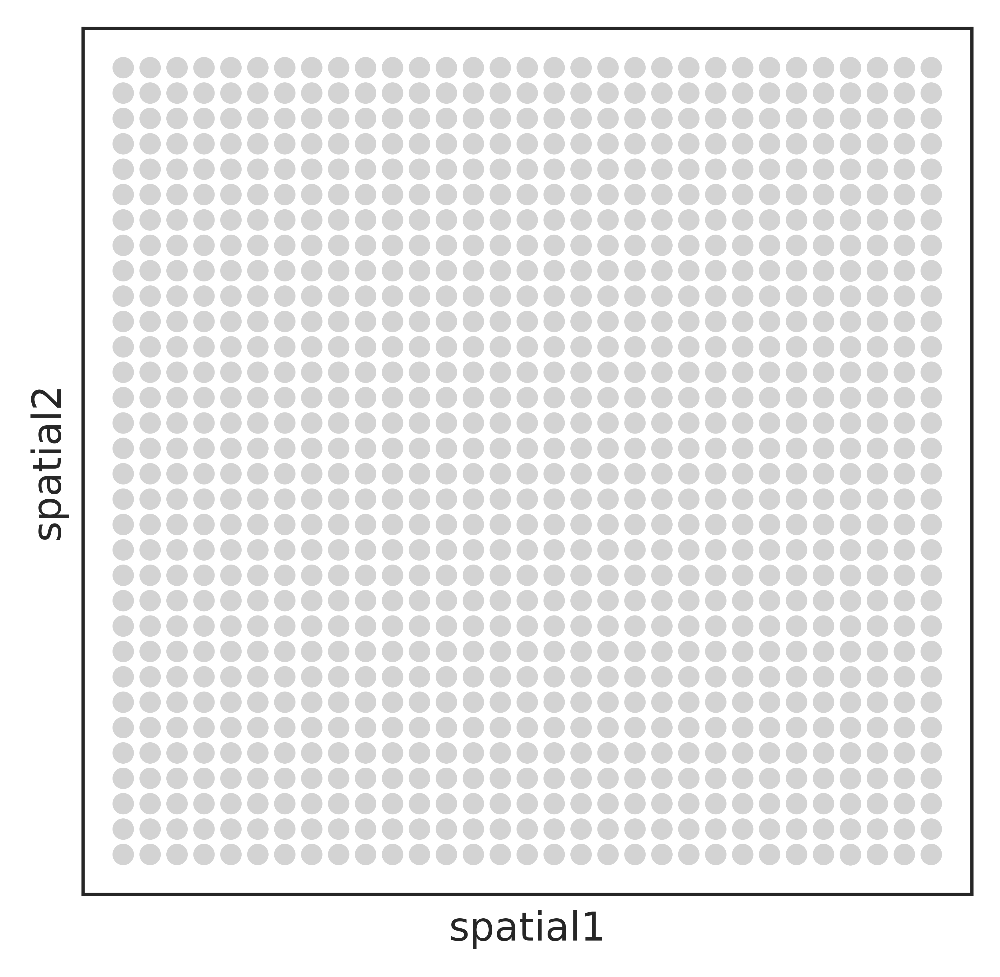

In [16]:
SEAM.pl.Cut(a_grid,method='dot')

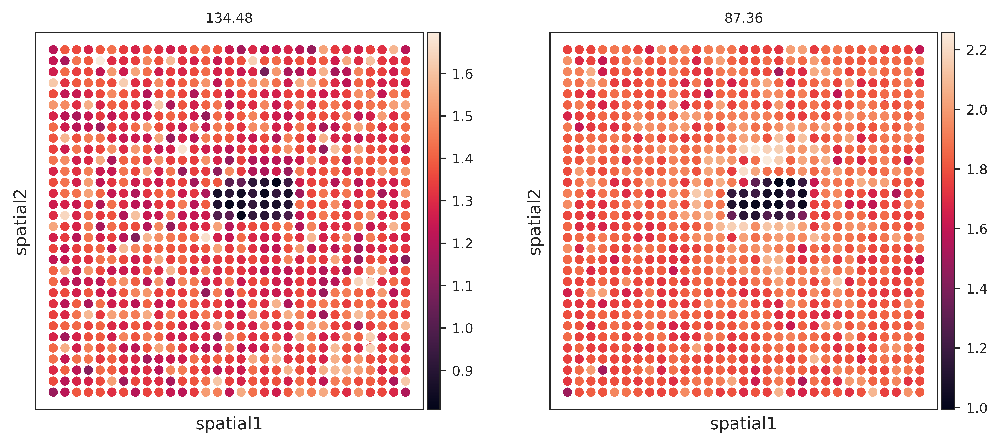

In [18]:
sc.pl.embedding(a_grid,basis='spatial',color=['134.48','87.36'])

# ID&Cluster

### run SIMS-ID with epochs and temperature.

In [22]:
# a = SEAM.tl.ID(a,epochs=200,t=5,batch_size=1024)
SEAM.tl.ID(a_grid,epochs=200,t=5,batch_size=1024,subsample=False,verbose=True)

running SIMS-ID...

Epoch 1/200
65536/65536 [==============================] - 1s 17us/step - loss: 6.9050 - softmax_loss: 6.9050 - center_loss: 0.6672
Epoch 2/200
65536/65536 [==============================] - 1s 9us/step - loss: 6.8202 - softmax_loss: 6.8202 - center_loss: 4.5784
Epoch 3/200
65536/65536 [==============================] - 1s 9us/step - loss: 6.7971 - softmax_loss: 6.7971 - center_loss: 7.7534
Epoch 4/200
65536/65536 [==============================] - 1s 9us/step - loss: 6.7758 - softmax_loss: 6.7758 - center_loss: 11.5309
Epoch 5/200
65536/65536 [==============================] - 1s 9us/step - loss: 6.7605 - softmax_loss: 6.7605 - center_loss: 14.3177
Epoch 6/200
65536/65536 [==============================] - 1s 9us/step - loss: 6.7511 - softmax_loss: 6.7511 - center_loss: 15.6008
Epoch 7/200
65536/65536 [==============================] - 1s 9us/step - loss: 6.7439 - softmax_loss: 6.7439 - center_loss: 16.3016
Epoch 8/200
65536/65536 [==============================] -

### dump intermediate results

In [120]:
a.write_h5ad('result/demo_dump/ID_grid8.h5ad')

### dpt

In [25]:
a_grid.uns['iroot'] = 434

In [26]:
sc.pp.neighbors(a_grid,use_rep='ID')
sc.tl.diffmap(a_grid)

computing neighbors
    finished (0:00:03)
computing Diffusion Maps using n_comps=15(=n_dcs)
computing transitions
    finished (0:00:00)
    eigenvalues of transition matrix
    [1.         0.99283236 0.95069987 0.9436125  0.92953205 0.9068676
     0.8990187  0.8859303  0.8486145  0.8346016  0.8268998  0.82381296
     0.8119823  0.8026794  0.789996  ]
    finished (0:00:00)


In [27]:
sc.tl.dpt(a_grid)

computing Diffusion Pseudotime using n_dcs=10
    finished (0:00:00)


In [28]:
sc.tl.leiden(a_grid)

running Leiden clustering
    finished (0:00:00)


In [29]:
sc.tl.umap(a_grid)

computing UMAP
    finished (0:00:03)


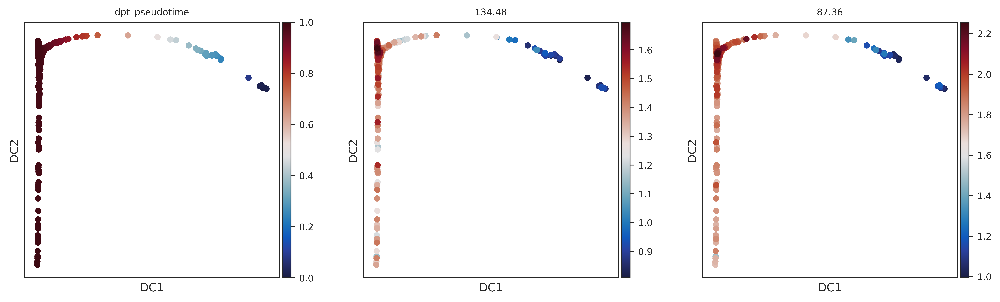

In [32]:
sc.pl.diffmap(a_grid,color=['dpt_pseudotime','134.48','87.36'],ncols=3,cmap=heatmap_cmp)

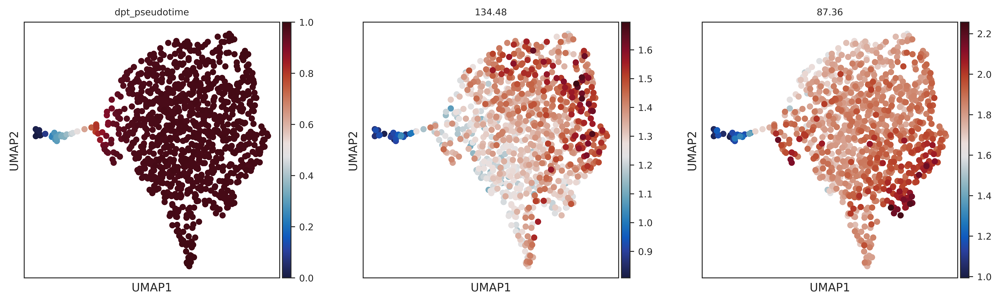

In [33]:
sc.pl.umap(a_grid,color=['dpt_pseudotime','134.48','87.36'],ncols=3,cmap=heatmap_cmp)

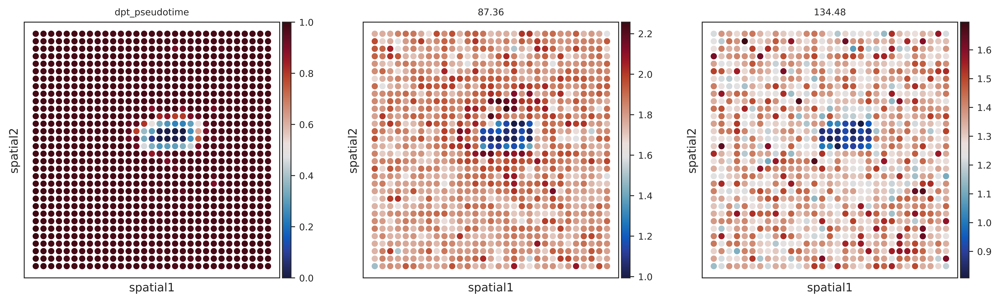

In [34]:
sc.pl.embedding(a_grid,basis='spatial',color=['dpt_pseudotime','87.36','134.48'],ncols=3,cmap=heatmap_cmp)

### SIMS-flow global metabolic features

In [47]:
n_dot_row = int(np.sqrt(a_grid.shape[0]))

dpt_mat = np.array(a_grid.obs['dpt_pseudotime'].copy()).reshape(n_dot_row,n_dot_row)
# m = '134.48'
# m = '255.83'
# m = '87.36'
# dpt_mat = np.array(a[:,m].X).reshape(n_dot_row,n_dot_row)
x_mat = a_grid.obsm['spatial'][:,0].reshape(n_dot_row,n_dot_row)
y_mat = a_grid.obsm['spatial'][:,1].reshape(n_dot_row,n_dot_row)
# x_mat = 255-x_mat
# x_mat = np.flipud(x_mat)
# y_mat = np.flipud(y_mat)
dpt_mat = np.flipud(dpt_mat)
# dpt_mat = np.fliplr(dpt_mat)

# y_mat = y_mat.max()-y_mat

In [48]:
dx, dy = np.gradient(dpt_mat)

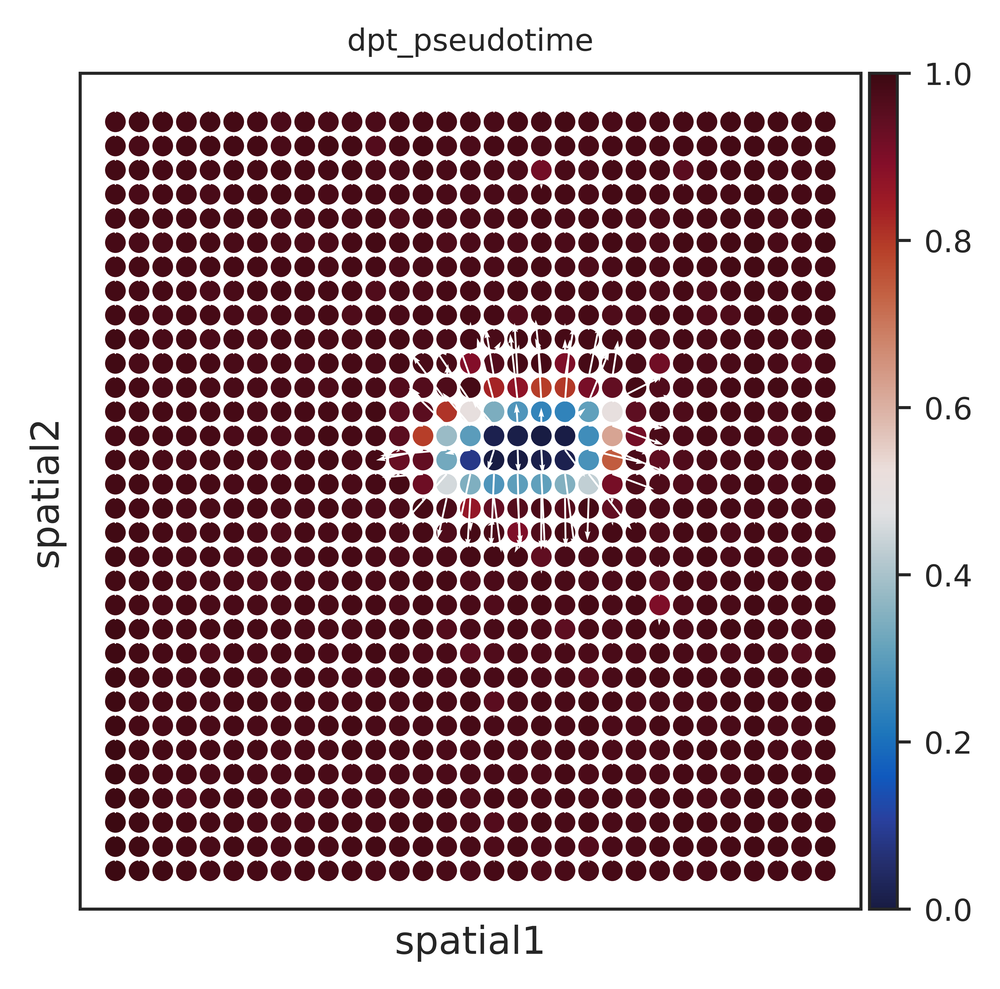

In [51]:
#
# SEAM.settings.heatmap_cmp
ax = sc.pl.embedding(a_grid,basis='spatial',color=['dpt_pseudotime'],show=False,color_map=SEAM.settings.heatmap_cmp)

ax.quiver(x_mat,y_mat,dy,dx,angles='xy',color='w',scale=5)

(-0.5, 255.5, 255.5, -0.5)

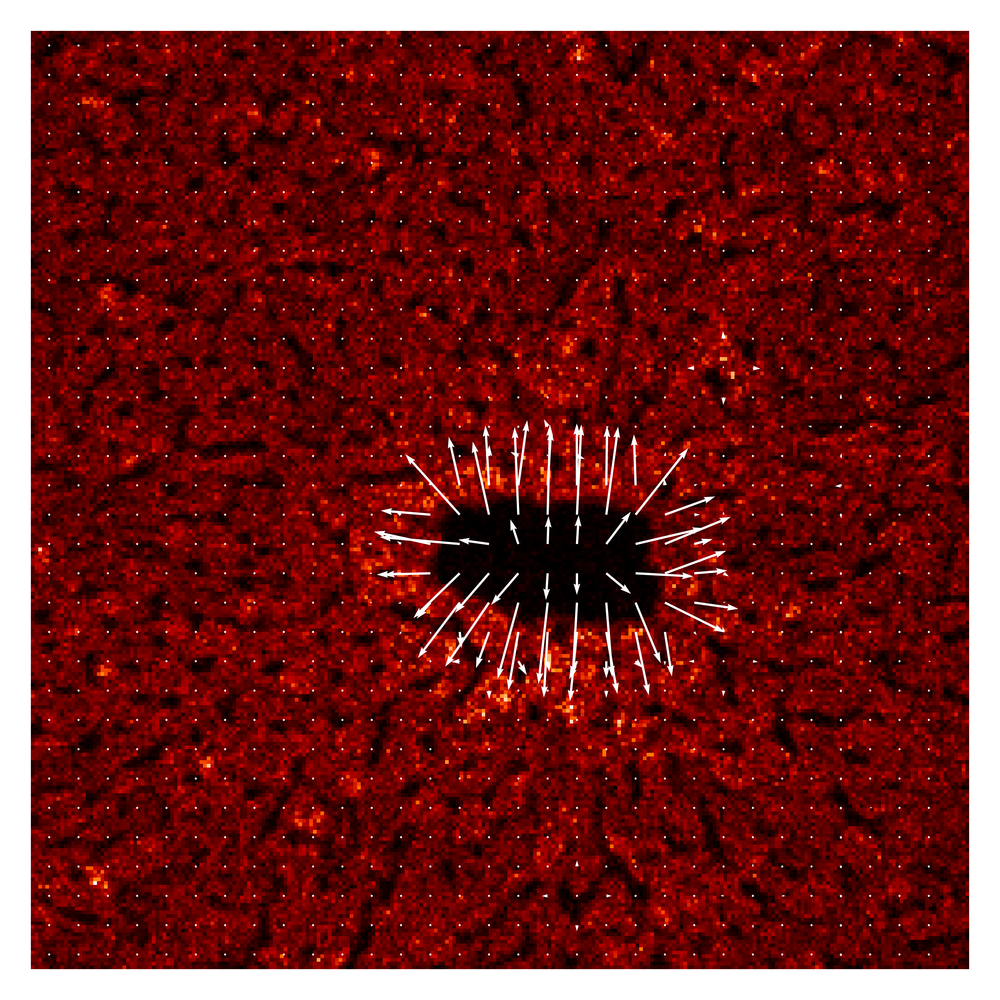

In [74]:
cmp_list = 'gist_heat'
IMS_87 = a.uns['IMS'][:,np.where(a.var_names=='87.36')].reshape(256,256)

IMS_87_t = np.rot90(IMS_87,2)
IMS_87_t = np.flip(IMS_87_t,axis=1)

# ax = sc.pl.embedding(a,basis='spatial',color=['87.36'],show=False,color_map=SEAM.settings.heatmap_cmp)
fig,ax = plt.subplots(1,1)
ax.imshow((IMS_87_t),cmap=cmp_list)
# ax.quiver(x_mat,y_mat,dy,dx,scale=5,color='w')
ax.quiver(x_mat,y_mat,dy,dx,angles='xy',color='w',scale=5)
ax.axis('off')

(-0.5, 255.5, 255.5, -0.5)

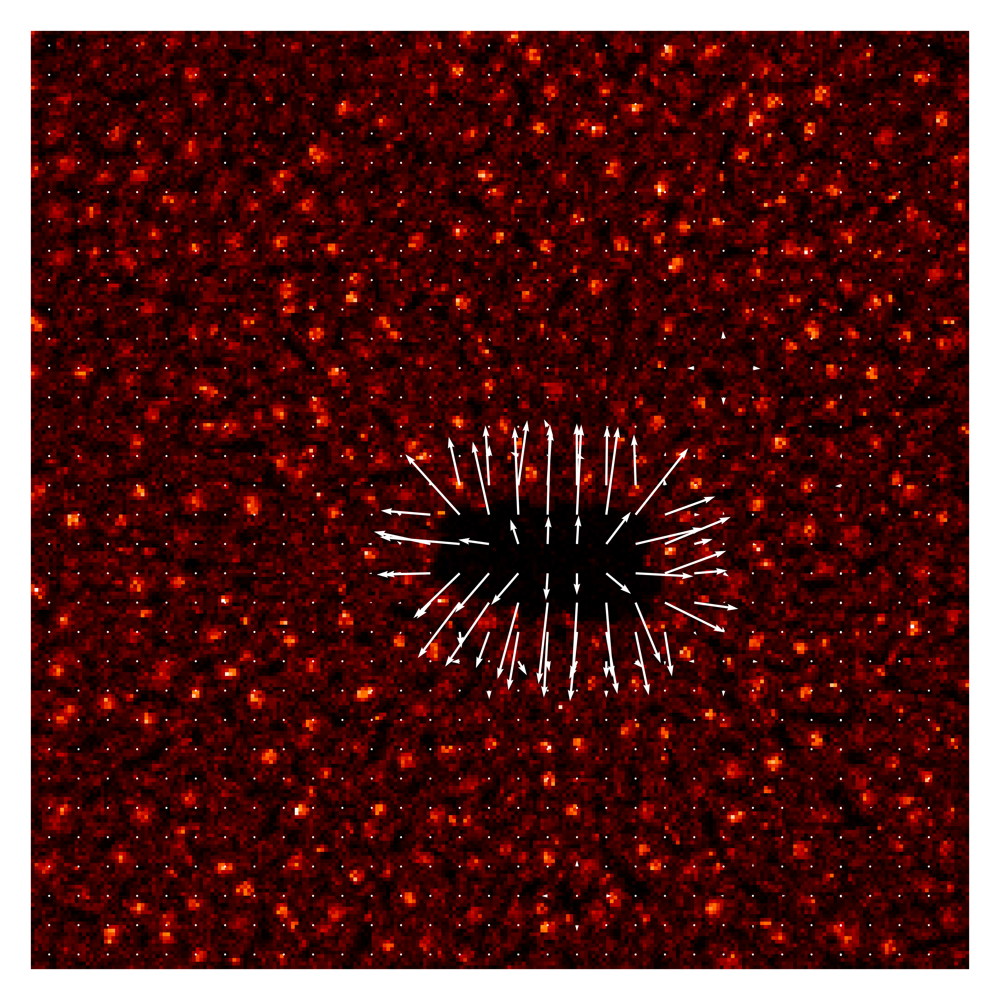

In [75]:
cmp_list = 'gist_heat'
IMS_87 = a.uns['IMS'][:,np.where(a.var_names=='134.48')].reshape(256,256)

IMS_87_t = np.rot90(IMS_87,2)
IMS_87_t = np.flip(IMS_87_t,axis=1)

# ax = sc.pl.embedding(a,basis='spatial',color=['87.36'],show=False,color_map=SEAM.settings.heatmap_cmp)
fig,ax = plt.subplots(1,1)
ax.imshow((IMS_87_t),cmap=cmp_list)
# ax.quiver(x_mat,y_mat,dy,dx,scale=5,color='w')
ax.quiver(x_mat,y_mat,dy,dx,angles='xy',color='w',scale=5)
ax.axis('off')

### SIMS-flow selected metabolic features (87.36)

In [76]:
n_dot_row = int(np.sqrt(a_grid.shape[0]))

# dpt_mat = np.array(a.obs['dpt_pseudotime'].copy()).reshape(n_dot_row,n_dot_row)
# m = '134.48'
# m = '255.83'
m = '87.36'
dpt_mat = np.array(a_grid[:,m].X).reshape(n_dot_row,n_dot_row)
x_mat = a_grid.obsm['spatial'][:,0].reshape(n_dot_row,n_dot_row)
y_mat = a_grid.obsm['spatial'][:,1].reshape(n_dot_row,n_dot_row)
# x_mat = 255-x_mat
# x_mat = np.flipud(x_mat)
# y_mat = np.flipud(y_mat)
dpt_mat = np.flipud(dpt_mat)
# dpt_mat = np.fliplr(dpt_mat)
dx, dy = np.gradient(dpt_mat)

# y_mat = y_mat.max()-y_mat

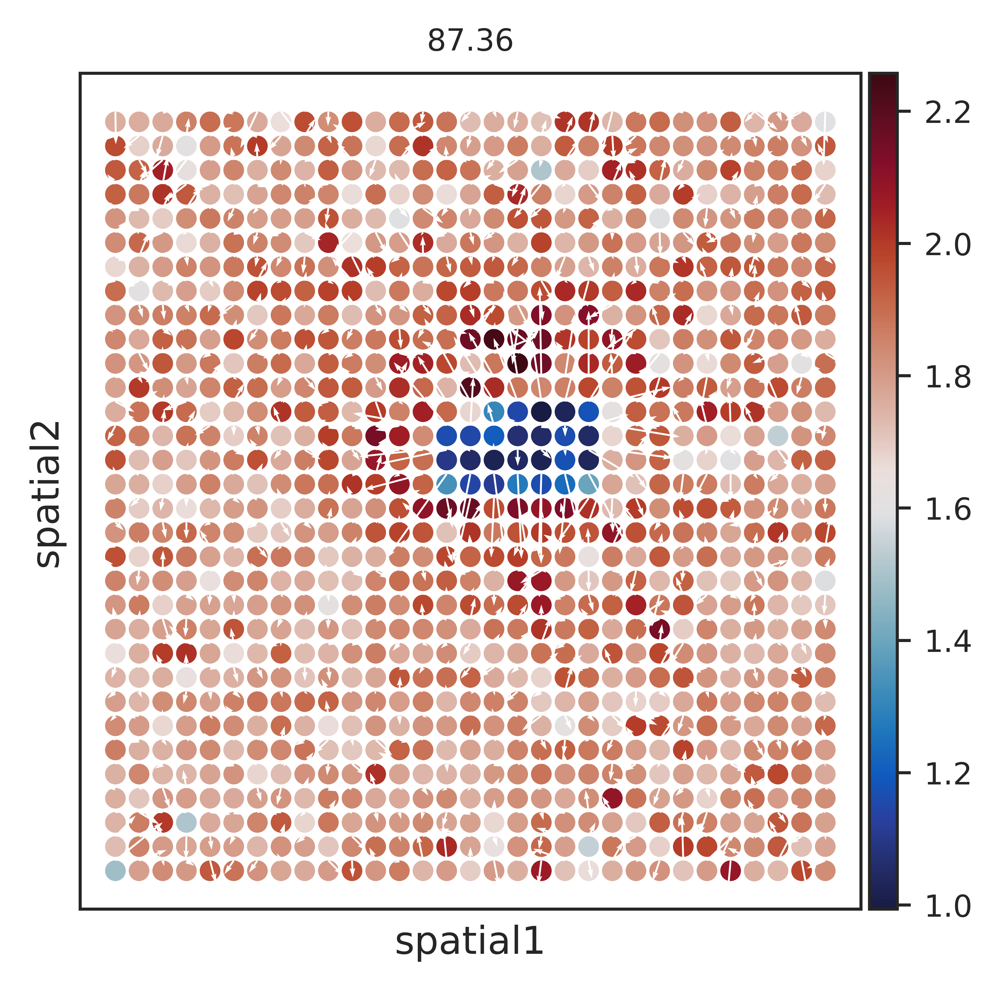

In [77]:
#
# SEAM.settings.heatmap_cmp
# fig,ax = plt.subplots()
ax = sc.pl.embedding(a_grid,basis='spatial',color=[m],show=False,color_map=SEAM.settings.heatmap_cmp)

ax.quiver(x_mat,y_mat,dy,dx,angles='xy',color='w',scale=5)

(-0.5, 255.5, 255.5, -0.5)

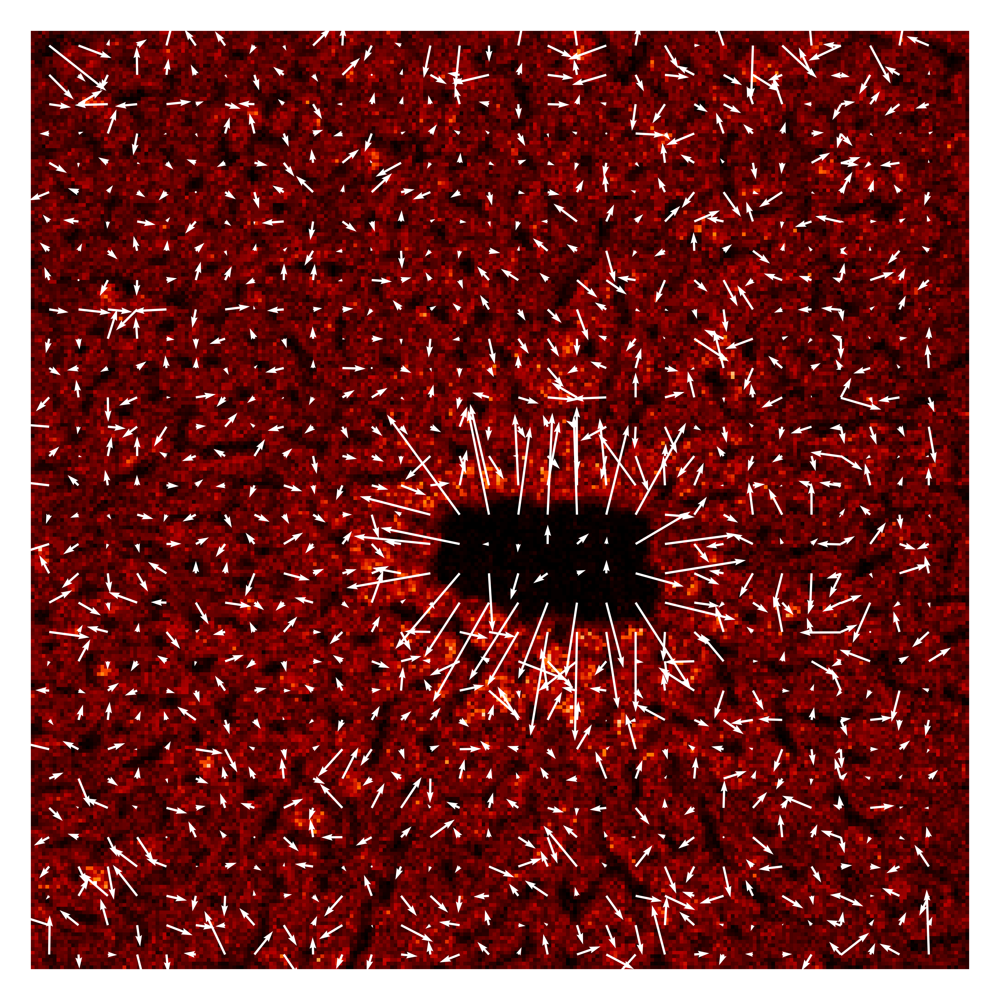

In [79]:
cmp_list = 'gist_heat'
IMS_87 = a.uns['IMS'][:,np.where(a.var_names=='87.36')].reshape(256,256)

IMS_87_t = np.rot90(IMS_87,2)
IMS_87_t = np.flip(IMS_87_t,axis=1)

# ax = sc.pl.embedding(a,basis='spatial',color=['87.36'],show=False,color_map=SEAM.settings.heatmap_cmp)
fig,ax = plt.subplots(1,1)
ax.imshow((IMS_87_t),cmap=cmp_list)
# ax.quiver(x_mat,y_mat,dy,dx,scale=5,color='w')
ax.quiver(x_mat,y_mat,dy,dx,angles='xy',color='w',scale=5)
ax.axis('off')

### SIMS-flow selected metabolic features (134.48)

In [80]:
n_dot_row = int(np.sqrt(a_grid.shape[0]))

# dpt_mat = np.array(a.obs['dpt_pseudotime'].copy()).reshape(n_dot_row,n_dot_row)
# m = '134.48'
# m = '255.83'
m = '134.48'
dpt_mat = np.array(a_grid[:,m].X).reshape(n_dot_row,n_dot_row)
x_mat = a_grid.obsm['spatial'][:,0].reshape(n_dot_row,n_dot_row)
y_mat = a_grid.obsm['spatial'][:,1].reshape(n_dot_row,n_dot_row)
# x_mat = 255-x_mat
# x_mat = np.flipud(x_mat)
# y_mat = np.flipud(y_mat)
dpt_mat = np.flipud(dpt_mat)
# dpt_mat = np.fliplr(dpt_mat)
dx, dy = np.gradient(dpt_mat)

# y_mat = y_mat.max()-y_mat

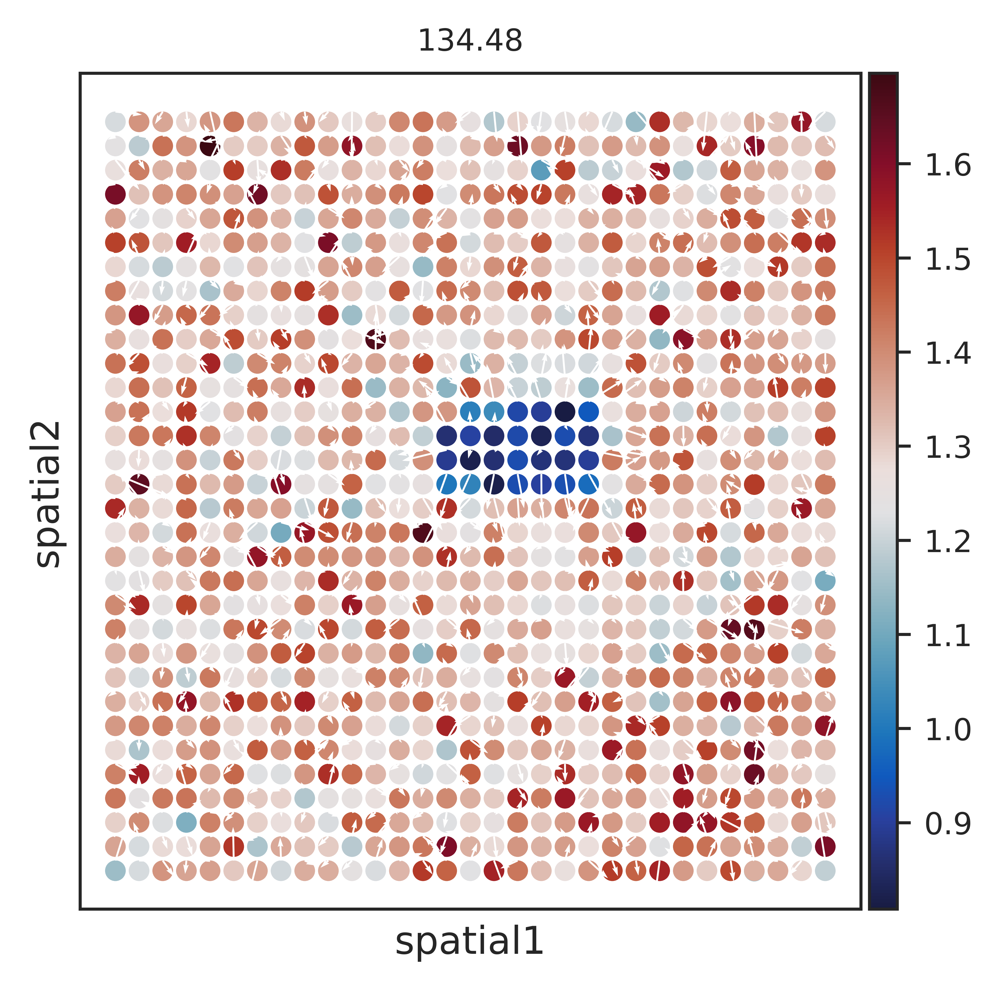

In [81]:
#
# SEAM.settings.heatmap_cmp
# fig,ax = plt.subplots()
ax = sc.pl.embedding(a_grid,basis='spatial',color=[m],show=False,color_map=SEAM.settings.heatmap_cmp)

ax.quiver(x_mat,y_mat,dy,dx,angles='xy',color='w',scale=5)

(-0.5, 255.5, 255.5, -0.5)

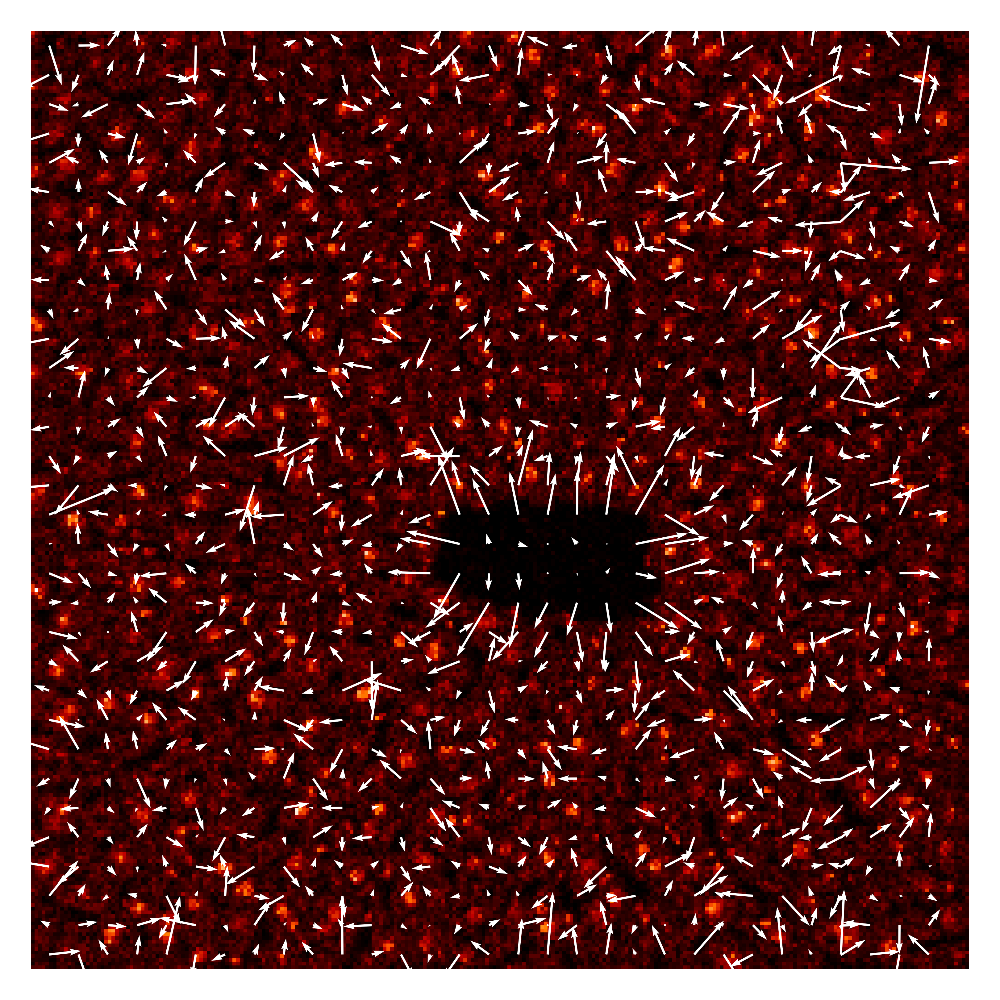

In [82]:
cmp_list = 'gist_heat'
IMS_87 = a.uns['IMS'][:,np.where(a.var_names=='134.48')].reshape(256,256)

IMS_87_t = np.rot90(IMS_87,2)
IMS_87_t = np.flip(IMS_87_t,axis=1)

# ax = sc.pl.embedding(a,basis='spatial',color=['87.36'],show=False,color_map=SEAM.settings.heatmap_cmp)
fig,ax = plt.subplots(1,1)
ax.imshow((IMS_87_t),cmap=cmp_list)
# ax.quiver(x_mat,y_mat,dy,dx,scale=5,color='w')
ax.quiver(x_mat,y_mat,dy,dx,angles='xy',color='w',scale=5)
ax.axis('off')